In [43]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
from sklearn.cluster import KMeans
import seaborn as sb 

from mpl_toolkits.mplot3d import Axes3D
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline

from itertools import combinations

In [2]:
plt.rcParams['font.family']='Malgun Gothic'
#그래프의 크기
plt.rcParams['figure.figsize']=12.8,10.8
#글자크기
plt.rcParams['font.size']=14
#폰트설정시 -가호 깨지는거 방지하기
plt.rcParams['axes.unicode_minus']=False
plt.rcParams['figure.facecolor']='white' #다크모드일때 그래프에 흰배경깔아줌

In [3]:
df = pd.read_csv('./2020_torunaments.csv')

In [4]:
df

,dbnos,assists,boosts,damage_dealt,death_type,headshot_kills,heals,kill_place,kill_streaks,kills,...,walk_distance,weapons_acquired,win_place,match_mapName,match_duration,match_createdAt,roster_rank,roster_won,tournament_id,tournament_createdAt
0,1,0,2,178.786790,byplayer,0,7,20,1,1,...,706.84840,7,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
1,0,0,1,0.000000,byplayer,0,1,33,0,0,...,630.31635,4,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
2,1,0,1,100.000000,byplayer,0,3,34,0,0,...,1328.34330,3,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
3,1,0,0,207.984300,byplayer,0,1,21,1,1,...,1109.39770,4,4,Miramar,1742,2020-12-19T07:39:25Z,4,False,as-pwi20,2020-12-19T07:04:54Z
4,1,0,3,189.195080,byplayer,1,6,25,1,1,...,1024.16360,3,8,Miramar,1742,2020-12-19T07:39:25Z,8,False,as-pwi20,2020-12-19T07:04:54Z
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135155,0,0,3,18.449999,byplayer,0,1,44,0,0,...,1137.94820,5,7,Miramar,1818,2020-01-10T13:16:32Z,7,False,kr-nr20,2020-01-08T11:45:46Z
135156,0,1,4,27.376270,byplayer,0,0,56,0,0,...,2369.78860,7,13,Miramar,1818,2020-01-10T13:16:32Z,13,False,kr-nr20,2020-01-08T11:45:46Z
135157,0,0,2,0.000000,byplayer,0,0,57,0,0,...,1164.91500,6,13,Miramar,1818,2020-01-10T13:16:32Z,13,False,kr-nr20,2020-01-08T11:45:46Z
135158,1,0,8,78.000000,byplayer,0,1,30,1,1,...,1480.25150,5,13,Miramar,1818,2020-01-10T13:16:32Z,13,False,kr-nr20,2020-01-08T11:45:46Z


In [16]:
idx_tid=df[df['tournament_id']=='eu-testq'].index
df=df.drop(idx_tid)

In [18]:
df=df.drop(['death_type','match_mapName','name','player_id','match_createdAt','roster_won','tournament_id','tournament_createdAt'],axis=1)

In [19]:
test_features = ['kills','assists','damage_dealt','time_survived','longest_kill']

In [20]:
test_df = pd.DataFrame(df, columns=test_features)

In [21]:
scaler = StandardScaler()

model = KMeans(n_clusters=5,init='k-means++',max_iter=1000,random_state=0)

pipeline = make_pipeline(scaler,model)



In [22]:
kmeans_model=pipeline.fit(test_df)
kmeans_model

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('kmeans',
                 KMeans(max_iter=1000, n_clusters=5, random_state=0))])

In [23]:
display(model.labels_)

array([4, 4, 4, ..., 4, 4, 4])

In [24]:
cen = model.cluster_centers_
cen

array([[ 0.81933461, -0.17840621,  0.48771356,  0.54405253,  1.47255566],
       [-0.57607657, -0.49146652, -0.7574944 , -1.23660585, -0.52322173],
       [ 0.14443066,  1.6568222 ,  0.6930514 ,  0.76550698, -0.07339515],
       [ 2.43476858,  1.33589336,  2.28294718,  1.17901894,  1.38924578],
       [-0.38377509, -0.31718374, -0.2596407 ,  0.24334618, -0.4333315 ]])

In [25]:
test_df['cluster'] = model.labels_

<AxesSubplot:xlabel='kills', ylabel='damage_dealt'>

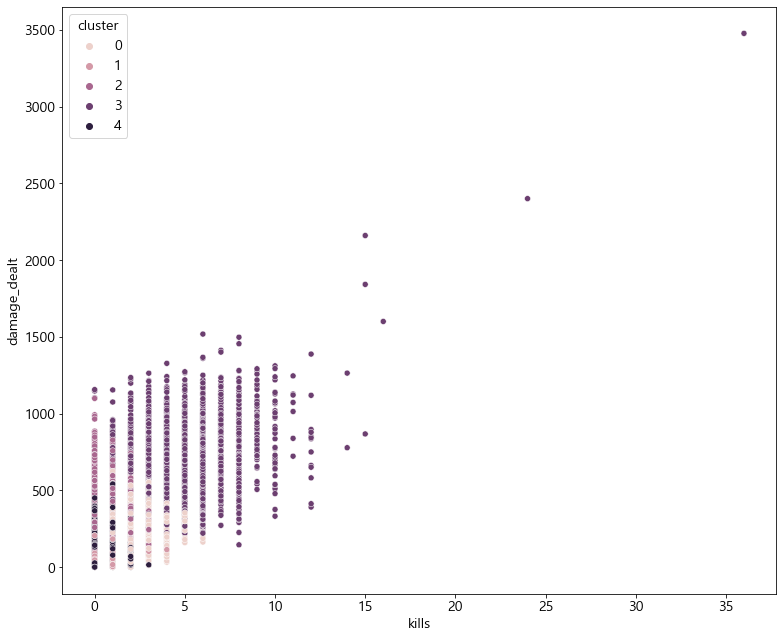

In [29]:
sb.scatterplot(x=test_df['kills'],y=test_df['damage_dealt'],hue=test_df['cluster'])

<AxesSubplot:xlabel='time_survived', ylabel='damage_dealt'>

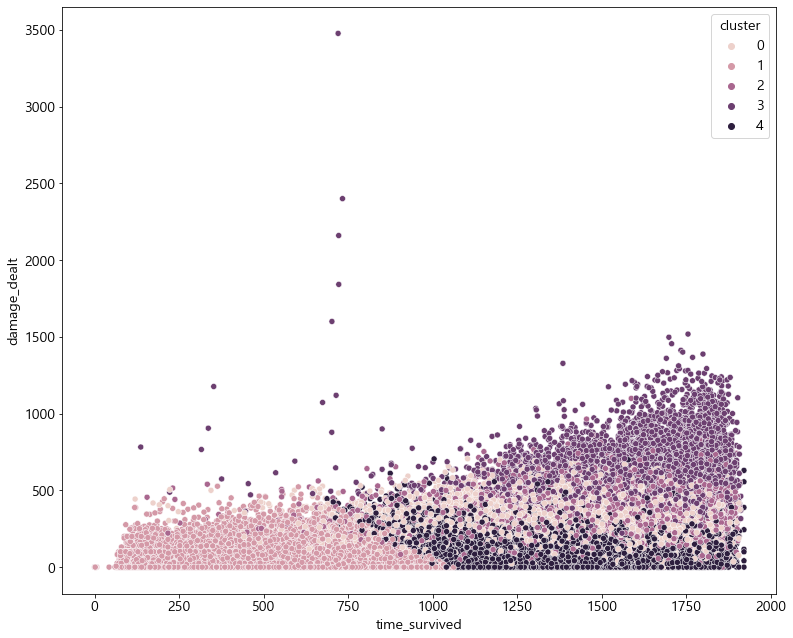

In [30]:
sb.scatterplot(x=test_df['time_survived'],y=test_df['damage_dealt'],hue=test_df['cluster'])

<AxesSubplot:xlabel='longest_kill', ylabel='damage_dealt'>

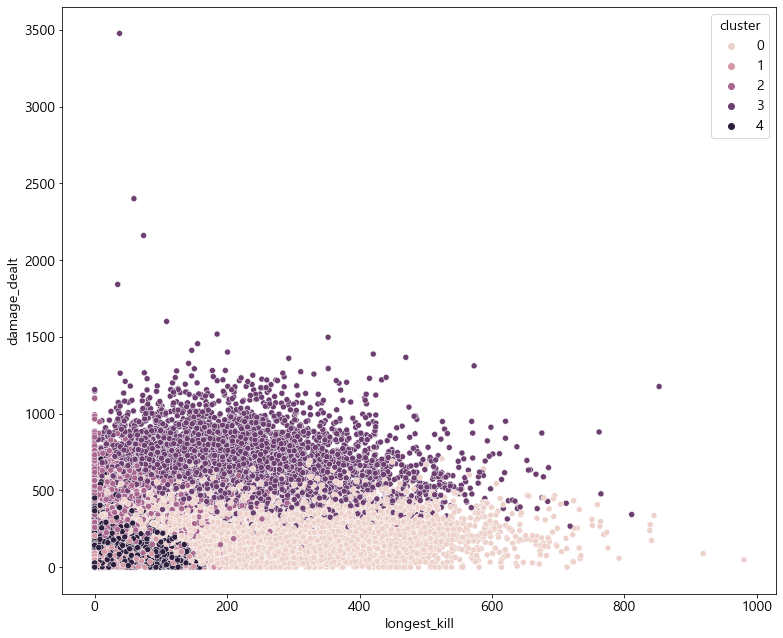

In [31]:
sb.scatterplot(x=test_df['longest_kill'],y=test_df['damage_dealt'],hue=test_df['cluster'])

### ▲임의의 column 설정하여 몇개 뽑아본것
### ▼ drop한 column 빼고 모든 column으로 돌린것

In [32]:
scaler = StandardScaler()

model = KMeans(n_clusters=5,init='k-means++', max_iter=1000, random_state=0)

pipeline = make_pipeline(scaler,model)

- pipeline으로 하지말고 standardscaler로 미리 df 따로 만들고 시작하기!

In [33]:
kmeans_model = pipeline.fit(df)
kmeans_model

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('kmeans',
                 KMeans(max_iter=1000, n_clusters=5, random_state=0))])

In [34]:
df['cluster'] = model.labels_

In [47]:
combs = combinations(df.iloc[:,:-1].columns, 2)

fig, ax = plt.subplots(51, 3, figsize=(12, 204), dpi=200)
for (col1, col2), axis in zip(combs, ax.flatten()):
    sb.scatterplot(data=df, x=col1, y=col2, hue='cluster', ax=axis)
    axis.set_xlabel(col1)
    axis.set_ylabel(col2)
fig.tight_layout()
plt.show()

C:\Users\medici\anaconda3\lib\site-packages\IPython\core\pylabtools.py:132: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


In [ ]:
data = []
for n in range(1,11):
    model = KMeans(n_clusters=n)
    km = pipeline.fit(df)
    data.append(km.inertia_)

In [ ]:
data

In [ ]:
plt.plot(range(1,11), data, 'ro--')
plt.show()

In [48]:
df

,dbnos,assists,boosts,damage_dealt,headshot_kills,heals,kill_place,kill_streaks,kills,longest_kill,...,swim_distance,team_kills,time_survived,vehicle_destroys,walk_distance,weapons_acquired,win_place,match_duration,roster_rank,cluster
0,1,0,2,178.786790,0,7,20,1,1,4.594472,...,0.0,0,1673.792,0,706.84840,7,4,1742,4,4
1,0,0,1,0.000000,0,1,33,0,0,0.000000,...,0.0,0,1101.193,0,630.31635,4,4,1742,4,4
2,1,0,1,100.000000,0,3,34,0,0,0.000000,...,0.0,0,1089.458,0,1328.34330,3,4,1742,4,4
3,1,0,0,207.984300,0,1,21,1,1,104.266150,...,0.0,0,1106.039,0,1109.39770,4,4,1742,4,0
4,1,0,3,189.195080,1,6,25,1,1,227.473070,...,0.0,0,1453.595,0,1024.16360,3,8,1742,8,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135155,0,0,3,18.449999,0,1,44,0,0,0.000000,...,0.0,0,1533.183,0,1137.94820,5,7,1818,7,4
135156,0,1,4,27.376270,0,0,56,0,0,0.000000,...,0.0,0,1295.836,0,2369.78860,7,13,1818,13,4
135157,0,0,2,0.000000,0,0,57,0,0,0.000000,...,0.0,0,1120.662,0,1164.91500,6,13,1818,13,1
135158,1,0,8,78.000000,0,1,30,1,1,23.056494,...,0.0,0,1258.413,0,1480.25150,5,13,1818,13,0


In [50]:
df=df.drop(['cluster'],axis=1)

In [51]:
df

,dbnos,assists,boosts,damage_dealt,headshot_kills,heals,kill_place,kill_streaks,kills,longest_kill,...,road_kills,swim_distance,team_kills,time_survived,vehicle_destroys,walk_distance,weapons_acquired,win_place,match_duration,roster_rank
0,1,0,2,178.786790,0,7,20,1,1,4.594472,...,0,0.0,0,1673.792,0,706.84840,7,4,1742,4
1,0,0,1,0.000000,0,1,33,0,0,0.000000,...,0,0.0,0,1101.193,0,630.31635,4,4,1742,4
2,1,0,1,100.000000,0,3,34,0,0,0.000000,...,0,0.0,0,1089.458,0,1328.34330,3,4,1742,4
3,1,0,0,207.984300,0,1,21,1,1,104.266150,...,0,0.0,0,1106.039,0,1109.39770,4,4,1742,4
4,1,0,3,189.195080,1,6,25,1,1,227.473070,...,0,0.0,0,1453.595,0,1024.16360,3,8,1742,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
135155,0,0,3,18.449999,0,1,44,0,0,0.000000,...,0,0.0,0,1533.183,0,1137.94820,5,7,1818,7
135156,0,1,4,27.376270,0,0,56,0,0,0.000000,...,0,0.0,0,1295.836,0,2369.78860,7,13,1818,13
135157,0,0,2,0.000000,0,0,57,0,0,0.000000,...,0,0.0,0,1120.662,0,1164.91500,6,13,1818,13
135158,1,0,8,78.000000,0,1,30,1,1,23.056494,...,0,0.0,0,1258.413,0,1480.25150,5,13,1818,13


In [53]:
scaler = StandardScaler()
scaler.fit(df)
scaled_df=scaler.transform(df)

In [54]:
scaled_df

array([[ 0.07619429, -0.588334  , -0.49361467, ..., -0.97178065,
        -0.00302249, -0.9674271 ],
       [-0.78467082, -0.588334  , -0.90213987, ..., -0.97178065,
        -0.00302249, -0.9674271 ],
       [ 0.07619429, -0.588334  , -0.90213987, ..., -0.97178065,
        -0.00302249, -0.9674271 ],
       ...,
       [-0.78467082, -0.588334  , -0.49361467, ...,  0.97047785,
         0.50779062,  0.9807647 ],
       [ 0.07619429, -0.588334  ,  1.95753651, ...,  0.97047785,
         0.50779062,  0.9807647 ],
       [-0.78467082, -0.588334  , -0.08508947, ...,  0.97047785,
         0.50779062,  0.9807647 ]])